<a href="https://colab.research.google.com/github/sjkim-audio/Bass-separator/blob/main/02_tracking_separated_bass.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
print("📦 라이브러리 재설치 중...")
!pip install "torchaudio>=2.0.0" soundfile
!pip install torchcodec
!pip install demucs

In [3]:
import os
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal
from IPython.display import Audio, display
from google.colab import drive

In [ ]:
import sys

# ==========================================
# [설정] 프로젝트 및 데이터 경로
# ==========================================
REPO_URL = "https://github.com/sjkim-audio/Bass-separator.git"
PROJECT_NAME = "Bass-separator"

# ==========================================
# 1. Git 프로젝트 설정 (Clone & Path)
# ==========================================
# 1-1. 깃허브에서 프로젝트 다운로드
if not os.path.exists(PROJECT_NAME):
    print(f"Cloning repository... ({PROJECT_NAME})")
    !git clone {REPO_URL}
else:
    print("Repository already exists.")

# 1-2. 작업 경로 변경 (Repo 폴더 안으로 이동)
if PROJECT_NAME not in os.getcwd():
    os.chdir(PROJECT_NAME)
    print(f"Changed working directory: {os.getcwd()}")

# 1-3. 시스템 경로 추가 (src 폴더 인식을 위함)
if os.getcwd() not in sys.path:
    sys.path.append(os.getcwd())

# 구글 드라이브 내 데이터셋 원본 위치
MY_DRIVE_PATH = "/content/drive/MyDrive/Bass_separator/dataset"
# src 의 데이터셋 로드 함수 실행
from src.utils import load_data_from_drive
load_data_from_drive(MY_DRIVE_PATH)


In [12]:
import subprocess

# [사용자 수정 영역] 분석할 오디오 파일의 경로를 입력

target_file_path = "/content/drive/MyDrive/Bass_separator/dataset/기타 베이스 분리 예제 2.wav"

# ==========================================
# 3. Demucs로 베이스 트랙 분리
# ==========================================
print("🚀 Demucs 분리 시작...")

# 파일명 추출 (확장자 제외)
filename = os.path.splitext(os.path.basename(target_file_path))[0]

# Demucs 실행 (htdemucs 모델 사용)
# -n htdemucs: 고성능 모델
# --two-stems=bass: '베이스'와 '나머지'로만 분리 (속도 절약)
cmd = f'demucs -n htdemucs "{target_file_path}"'
process = subprocess.run(cmd, shell=True, capture_output=True, text=True, check=False)

# 분리된 베이스 파일 경로 자동 탐색
# Demucs 기본 출력 경로: separated/htdemucs/파일명/bass.wav
bass_stem_path = os.path.join('separated', 'htdemucs', filename, 'bass.wav')

if not os.path.exists(bass_stem_path):
    print("Demucs Command Output:")
    print(process.stdout)
    print("Demucs Command Error:")
    print(process.stderr)
    raise FileNotFoundError(f"❌ 분리 실패! 경로에 파일이 없습니다: {bass_stem_path}. Demucs 실행 로그를 확인하세요.")

print(f"✅ 분리 완료! 베이스 트랙 경로: {bass_stem_path}")

# 오디오 재생
print("🎧 분리된 베이스 트랙 듣기:")
display(Audio(bass_stem_path))

🚀 Demucs 분리 시작...
✅ 분리 완료! 베이스 트랙 경로: separated/htdemucs/기타 베이스 분리 예제 2/bass.wav
🎧 분리된 베이스 트랙 듣기:


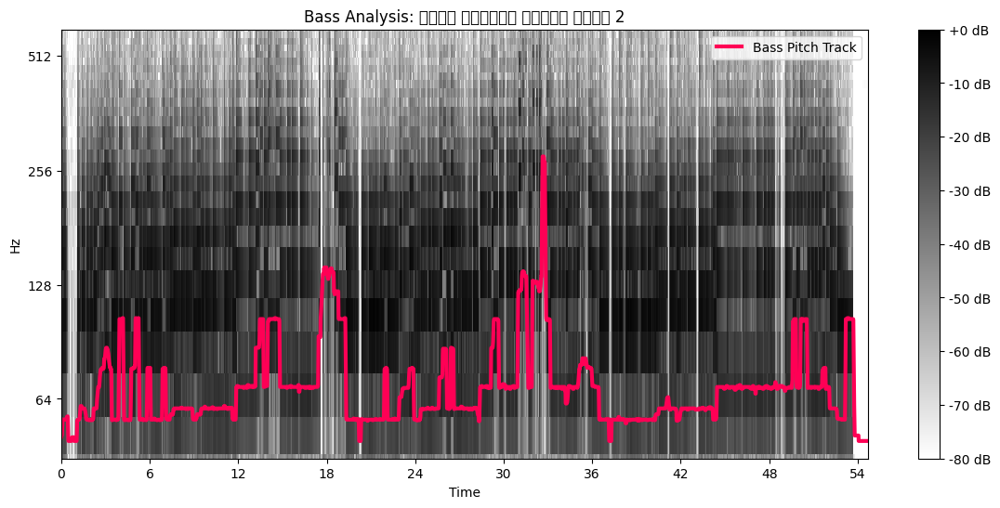

🎧 분리된 베이스 트랙 듣기:


In [14]:
# ==========================================
# 4. 베이스 트랙 로드 및 피치 트래킹
# ==========================================

# 오디오 로드
y, sr = librosa.load(bass_stem_path, sr=44100)

# [핵심] 베이스 기타에 최적화된 파라미터 튜닝
# 베이스 음역: E1(41Hz) ~ G4(392Hz) 근처
f0, voiced_flag, voiced_probs = librosa.pyin(
    y,
    fmin=40,
    fmax=400,
    sr=sr,
    hop_length=512,
    frame_length=4096, # 👈 저음 해상도를 위해 윈도우 크기를 2배로 늘림 (중요)
    fill_na=None
)

# [후처리] 미디언 필터로 튀는 값(Outlier) 보정
if np.any(np.isfinite(f0)):
    f0_clean = scipy.signal.medfilt(f0, kernel_size=5)
else:
    f0_clean = f0

# ==========================================
# 5. 결과 시각화 및 청취
# ==========================================
plt.figure(figsize=(14, 6))

# 배경: 스펙트로그램
D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
librosa.display.specshow(D, x_axis='time', y_axis='log', sr=sr, cmap='gray_r')

# 전경: 추출한 피치 (빨간 선)
times = librosa.times_like(f0, sr=sr)
plt.plot(times, f0_clean, label='Bass Pitch Track', color='#ff0055', linewidth=3)

# 그래프 설정
plt.ylim(30, 600) # 베이스 음역대에 맞춰 줌인
plt.title(f'Bass Analysis: {filename}')
plt.legend(loc='upper right')
plt.colorbar(format='%+2.0f dB')
plt.show()

# 오디오 재생
print("🎧 분리된 베이스 트랙 듣기:")
display(Audio(bass_stem_path))

In [15]:
import numpy as np
import librosa

class SimpleBassTab:
    def __init__(self):
        # 4현 베이스 표준 튜닝 (MIDI Note Number)
        # 4번줄(E1)=28, 3번줄(A1)=33, 2번줄(D2)=38, 1번줄(G2)=43
        self.tuning = [28, 33, 38, 43]
        self.string_names = ["E", "A", "D", "G"]

    def hz_to_fret(self, hz):
        """주파수(Hz)를 받아서 (줄번호, 프렛)을 반환"""
        if hz is None or hz == 0 or np.isnan(hz):
            return None # 무음

        # 1. Hz -> MIDI 노트 번호 변환 (반올림)
        midi_note = int(round(librosa.hz_to_midi(hz)))

        # 2. 가능한 모든 운지 위치(Position) 찾기
        candidates = []
        for string_idx, open_note in enumerate(self.tuning):
            fret = midi_note - open_note
            # 베이스는 보통 0~24프렛
            if 0 <= fret <= 24:
                candidates.append((string_idx, fret))

        if not candidates:
            return None # 표현 불가능한 음 (너무 낮거나 높음)

        # 3. [알고리즘] 가장 쉬운 운지 선택 (프렛 번호가 가장 낮은 것)
        # 예: 개방현(0프렛)이 가능하면 무조건 0프렛 선택
        best_pos = min(candidates, key=lambda x: x[1])

        return best_pos # (줄인덱스, 프렛번호) 반환

    def print_tab(self, f0_array, sr, hop_length, time_step=0.2):
        """
        f0 데이터를 읽어서 타브 악보를 출력
        time_step: 악보를 그리는 시간 간격 (초 단위, 기본 0.2초)
        """
        print(f"{'Time':<8} | {'Note':<5} | {'Tab (G-D-A-E)'}")
        print("-" * 40)

        # 데이터를 너무 많이 출력하면 보기 힘드니, 일정 간격으로 샘플링
        frames_per_step = int(time_step * sr / hop_length)

        prev_note = -1 # 중복 출력 방지용

        for i in range(0, len(f0_array), frames_per_step):
            pitch = f0_array[i]
            current_time = i * hop_length / sr

            # 피치가 없거나(NaN) 0인 경우 패스 (쉼표)
            if np.isnan(pitch) or pitch == 0:
                continue

            pos = self.hz_to_fret(pitch)
            if pos:
                string_idx, fret = pos
                note_name = librosa.midi_to_note(int(round(librosa.hz_to_midi(pitch))))

                # 시각화: 4줄 타브 (G D A E 순서)
                # 선택된 줄에만 숫자를 넣고 나머지는 '-'
                tab_visual = ["-"] * 4
                # string_idx: 0(E)~3(G). 타브는 위가 G(3) 아래가 E(0)
                tab_visual[3 - string_idx] = str(fret)

                tab_str = "|".join(tab_visual)

                print(f"{current_time:5.1f}s  | {note_name:<5} |  {tab_str}")

# ==========================================
# 실행 코드
# ==========================================
# 앞선 코드에서 구한 f0_clean 데이터 사용
generator = SimpleBassTab()

print("\n🎸 Generated Bass Tab (Sampling every 0.2s)")
print("G | D | A | E  (Standard Tuning)")
print("=" * 40)

# f0_clean: 앞선 피치 트래킹 결과 변수
# hop_length: 앞선 설정값 (512)
generator.print_tab(f0_clean, sr=44100, hop_length=512, time_step=0.25)


🎸 Generated Bass Tab (Sampling every 0.2s)
G | D | A | E  (Standard Tuning)
Time     | Note  | Tab (G-D-A-E)
----------------------------------------
  0.0s  | E1    |  -|-|-|0
  0.2s  | G♯1   |  -|-|-|4
  0.7s  | E1    |  -|-|-|0
  1.2s  | G♯1   |  -|-|-|4
  1.5s  | A♯1   |  -|-|1|-
  1.7s  | G♯1   |  -|-|-|4
  2.0s  | G♯1   |  -|-|-|4
  2.2s  | A♯1   |  -|-|1|-
  2.4s  | C2    |  -|-|3|-
  2.7s  | D♯2   |  -|1|-|-
  2.9s  | E2    |  -|2|-|-
  3.2s  | F2    |  -|3|-|-
  3.4s  | B1    |  -|-|2|-
  3.7s  | G♯1   |  -|-|-|4
  3.9s  | C2    |  -|-|3|-
  4.1s  | G♯2   |  1|-|-|-
  4.4s  | G♯1   |  -|-|-|4
  4.6s  | G♯1   |  -|-|-|4
  4.9s  | D♯2   |  -|1|-|-
  5.1s  | G♯2   |  1|-|-|-
  5.4s  | G♯1   |  -|-|-|4
  5.6s  | G♯1   |  -|-|-|4
  5.9s  | D♯2   |  -|1|-|-
  6.1s  | G♯1   |  -|-|-|4
  6.3s  | G♯1   |  -|-|-|4
  6.6s  | G♯1   |  -|-|-|4
  6.8s  | G♯1   |  -|-|-|4
  7.1s  | D♯2   |  -|1|-|-
  7.3s  | G♯1   |  -|-|-|4
  7.6s  | A1    |  -|-|0|-
  7.8s  | A♯1   |  -|-|1|-
  8.0s  | A♯